# GO TERMS
#### matrix > tsne3D > cluster > 3D portrait

In [38]:
from multidimvis_main import *

In [39]:
G = nx.read_edgelist('input/ppi_elist.txt',data=False)

d_gene_do = pickle.load( open( "input/d_gene_do.pkl", "rb" ) )
d_do_genes = pickle.load( open( "input/d_do_genes.pkl", "rb" ) )
d_do_names = pickle.load( open( "input/DO_names.pkl", "rb" ) )
d_names_do = {y:x for x,y in d_do_names.items()}

In [41]:
DM_CC = pd.read_csv('output_csv/DistanceMatrix_goCC_Dataframe_Human.csv', index_col=0)

In [42]:
DM_BP = pd.read_csv('output_csv/DistanceMatrix_goBP_Dataframe_Human.csv', index_col=0)

In [43]:
DM_MF = pd.read_csv('output_csv/DistanceMatrix_goMF_Dataframe_Human.csv', index_col=0)

In [45]:
# precalculated import
df_centralities = pd.read_csv('output_csv/Features_centralities_Dataframe_Human.csv', index_col=0)

d_deghubs = dict(zip(G.nodes(),df_centralities['degs']))
d_clos = dict(zip(G.nodes(), df_centralities['clos']))
d_betw = dict(zip(G.nodes(), df_centralities['betw']))
d_eigen = dict(zip(G.nodes(), df_centralities['eigen']))

d_centralities = dict(zip(list(G.nodes),zip(d_deghubs.values(),d_clos.values(),d_betw.values(),d_eigen.values())))
l_features = []
for i in d_centralities.items():
    k=list(i)
    l_features.append(k)
    
DM_centralities = pd.DataFrame(distance.squareform(distance.pdist(df_centralities, 'euclidean')))

________
### 3D tSNE

In [46]:
prplxty3d = 50 # range: 5-50 / default = 30.#
density3d = 1.2 # default 12.
l_rate3d = 200 # default 200.
steps3d = 250 #min 250

metric = 'correlation'
#metric = 'cosine'

In [47]:
feature = 'CC'
DM = DM_CC
l_genes = list(DM_CC.index)
l_featur= l_genes

In [ ]:
%%time 
tsne = embed_tsne_3D(DM,  prplxty3d, density3d, l_rate3d, steps3d, metric)

In [ ]:
%%time 
posG = get_posG_3D_(l_genes, tsne)

df_xyz_portrait_tsne = pd.DataFrame(posG, index=["x","y","z"]).T
df_xyz_portrait_tsne.to_csv(r'output_csv/3Dportrait_tsne_XYZ_'+feature+'_Human.csv', index = True)

In [13]:
scalef= 5
d_node_size = d_deghubs
size3d = draw_node_size(G, d_node_size, scalef)

edge_color = 'grey'
edge_width = 0.1

opacity_nodes = 1
opacity_edges = 0.3

In [14]:
# CLUSTERS 

df_posG = pd.DataFrame(posG).T

n_clus = 10
n_iterations = 50

d_node_clusterid = get_node_clusterid(df_posG, n_clus, n_iterations)
cluster_center_x, cluster_center_y, cluster_center_z = get_clustercenter_xyz(df_posG, n_clus, n_iterations)

colours = color_nodes_from_dict(G, d_node_clusterid)

trace_centers = pgo.Scatter3d(x = cluster_center_x,
                             y = cluster_center_y,
                             z = cluster_center_z,
                                 mode = 'markers',
                                 marker=dict(
                                    size=3,
                                    color='lightgrey',
                                    opacity=1)
                                 )

annotations = [dict(
                x=xi,
                y=yi,
                z=zi,
                showarrow=True,
                text="Cluster: "+str(i),
                xanchor="right",
                ay=-100,
                ax=-100,
                opacity=0.8,
                arrowhead=0,
                arrowwidth=0.5,
                arrowcolor="white"
                ) for i, xi, yi, zi in zip(range(1,n_clus+1), cluster_center_x,cluster_center_y,cluster_center_z)]

In [15]:
tsne_nodes = get_trace_nodes_(posG, l_features, colours, size3d)

# tsne_data = [tsne_edges, tsne_nodes]
# tsne_data = [tsne_nodes, trace_centers]


tsne_data = [tsne_nodes]

Perplexity: 50
Early Exaggeration: 1.2
Learning rate: 200
Iterations: 250


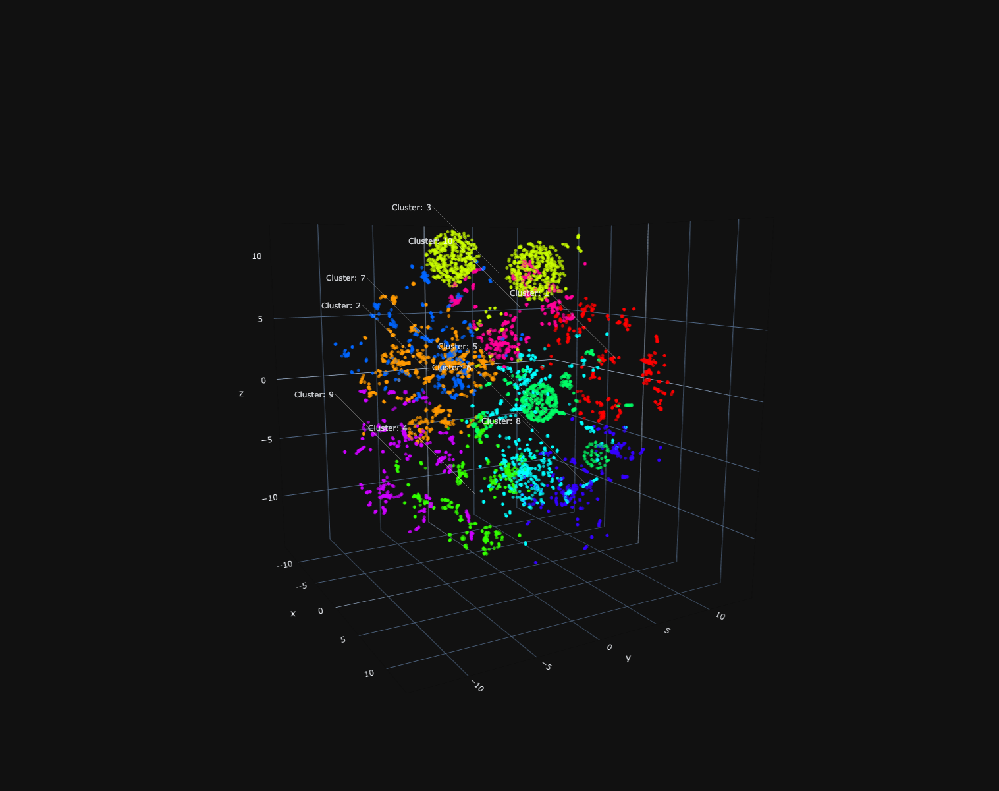

'output_plots/3Dportrait_tsne_CC_correlation_Human.html'

In [16]:
print('Perplexity:', prplxty3d)
print('Early Exaggeration:', density3d)
print('Learning rate:', l_rate3d)
print('Iterations:', steps3d)

fig = pgo.Figure()
for i in tsne_data:
    fig.add_trace(i)
fig.update_layout(template='plotly_dark', showlegend=False, width=1200, height=1200,
                  scene=dict(
                    aspectratio=dict(
                        x=1,
                        y=1,
                        z=1
                    ),
                    camera=dict(
                        center=dict(
                            x=0,
                            y=0,
                            z=0
                        ),
                        eye=dict(
                            x=1.96903462608,
                            y=-1.09022831971,
                            z=0.405345349304
                        ),
                        up=dict(
                            x=0,
                            y=0,
                            z=1
                        )
                    ),
                    dragmode="turntable",
                    annotations=annotations,
                ))
py.iplot(fig)

plotly.offline.plot(fig, filename = 'output_plots/3Dportrait_tsne_'+feature+'_'+metric+'_Human.html', auto_open=False)

_______

In [ ]:
feature = 'BP'
DM = DM_BP
l_genes = list(DM_BP.index)
l_features = l_genes

In [ ]:
%%time 
tsne = embed_tsne_3D(DM,  prplxty3d, density3d, l_rate3d, steps3d, metric)

In [ ]:
%%time 
posG = get_posG_3D_(l_genes, tsne)

df_xyz_portrait_tsne = pd.DataFrame(posG, index=["x","y","z"]).T
df_xyz_portrait_tsne.to_csv(r'output_csv/3Dportrait_tsne_XYZ_'+feature+'_Human.csv', index = True)

In [20]:
scalef= 5
d_node_size = d_deghubs
size3d = draw_node_size(G, d_node_size, scalef)

edge_color = 'grey'
edge_width = 0.1

opacity_nodes = 1
opacity_edges = 0.3

In [21]:
# CLUSTERS 

df_posG = pd.DataFrame(posG).T

n_clus = 10
n_iterations = 50

d_node_clusterid = get_node_clusterid(df_posG, n_clus, n_iterations)
cluster_center_x, cluster_center_y, cluster_center_z = get_clustercenter_xyz(df_posG, n_clus, n_iterations)

colours = color_nodes_from_dict(G, d_node_clusterid)

trace_centers = pgo.Scatter3d(x = cluster_center_x,
                             y = cluster_center_y,
                             z = cluster_center_z,
                                 mode = 'markers',
                                 marker=dict(
                                    size=3,
                                    color='lightgrey',
                                    opacity=1)
                                 )

annotations = [dict(
                x=xi,
                y=yi,
                z=zi,
                showarrow=True,
                text="Cluster: "+str(i),
                xanchor="right",
                ay=-100,
                ax=-100,
                opacity=0.8,
                arrowhead=0,
                arrowwidth=0.5,
                arrowcolor="white"
                ) for i, xi, yi, zi in zip(range(1,n_clus+1), cluster_center_x,cluster_center_y,cluster_center_z)]

In [22]:
tsne_nodes = get_trace_nodes_(posG, l_features, colours, size3d)

# tsne_data = [tsne_edges, tsne_nodes]
# tsne_data = [tsne_nodes, trace_centers]


tsne_data = [tsne_nodes]

Perplexity: 50
Early Exaggeration: 1.2
Learning rate: 200
Iterations: 250


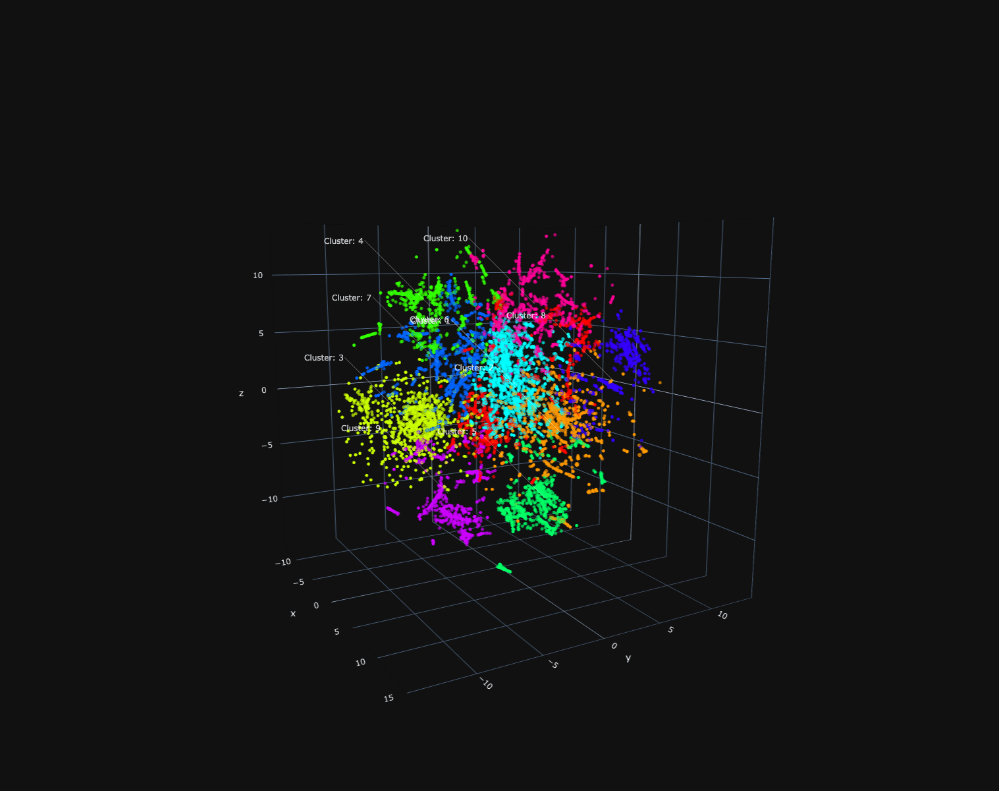

'output_plots/3Dportrait_tsne_BP_correlation_Human.html'

In [23]:
print('Perplexity:', prplxty3d)
print('Early Exaggeration:', density3d)
print('Learning rate:', l_rate3d)
print('Iterations:', steps3d)

fig = pgo.Figure()
for i in tsne_data:
    fig.add_trace(i)
fig.update_layout(template='plotly_dark', showlegend=False, width=1200, height=1200,
                  scene=dict(
                    aspectratio=dict(
                        x=1,
                        y=1,
                        z=1
                    ),
                    camera=dict(
                        center=dict(
                            x=0,
                            y=0,
                            z=0
                        ),
                        eye=dict(
                            x=1.96903462608,
                            y=-1.09022831971,
                            z=0.405345349304
                        ),
                        up=dict(
                            x=0,
                            y=0,
                            z=1
                        )
                    ),
                    dragmode="turntable",
                    annotations=annotations,
                ))
py.iplot(fig)

plotly.offline.plot(fig, filename = 'output_plots/3Dportrait_tsne_'+feature+'_'+metric+'_Human.html', auto_open=False)

_________

In [ ]:
feature = 'MF'
DM = DM_MF
l_genes = list(DM_MF.index)
l_features = l_genes

In [ ]:
%%time 
tsne = embed_tsne_3D(DM,  prplxty3d, density3d, l_rate3d, steps3d, metric)

In [ ]:
%%time 
posG = get_posG_3D_(l_genes, tsne)

df_xyz_portrait_tsne = pd.DataFrame(posG, index=["x","y","z"]).T
df_xyz_portrait_tsne.to_csv(r'output_csv/3Dportrait_tsne_XYZ_'+feature+'_Human.csv', index = True)

In [27]:
scalef= 5
d_node_size = d_deghubs
size3d = draw_node_size(G, d_node_size, scalef)

edge_color = 'grey'
edge_width = 0.1

opacity_nodes = 1
opacity_edges = 0.3

In [28]:
# CLUSTERS 

df_posG = pd.DataFrame(posG).T

n_clus = 10
n_iterations = 50

d_node_clusterid = get_node_clusterid(df_posG, n_clus, n_iterations)
cluster_center_x, cluster_center_y, cluster_center_z = get_clustercenter_xyz(df_posG, n_clus, n_iterations)

colours = color_nodes_from_dict(G, d_node_clusterid)

trace_centers = pgo.Scatter3d(x = cluster_center_x,
                             y = cluster_center_y,
                             z = cluster_center_z,
                                 mode = 'markers',
                                 marker=dict(
                                    size=3,
                                    color='lightgrey',
                                    opacity=1)
                                 )

annotations = [dict(
                x=xi,
                y=yi,
                z=zi,
                showarrow=True,
                text="Cluster: "+str(i),
                xanchor="right",
                ay=-100,
                ax=-100,
                opacity=0.8,
                arrowhead=0,
                arrowwidth=0.5,
                arrowcolor="white"
                ) for i, xi, yi, zi in zip(range(1,n_clus+1), cluster_center_x,cluster_center_y,cluster_center_z)]

In [29]:
tsne_nodes = get_trace_nodes_(posG, l_features, colours, size3d)

# tsne_data = [tsne_edges, tsne_nodes]
# tsne_data = [tsne_nodes, trace_centers]


tsne_data = [tsne_nodes]

Perplexity: 50
Early Exaggeration: 1.2
Learning rate: 200
Iterations: 250


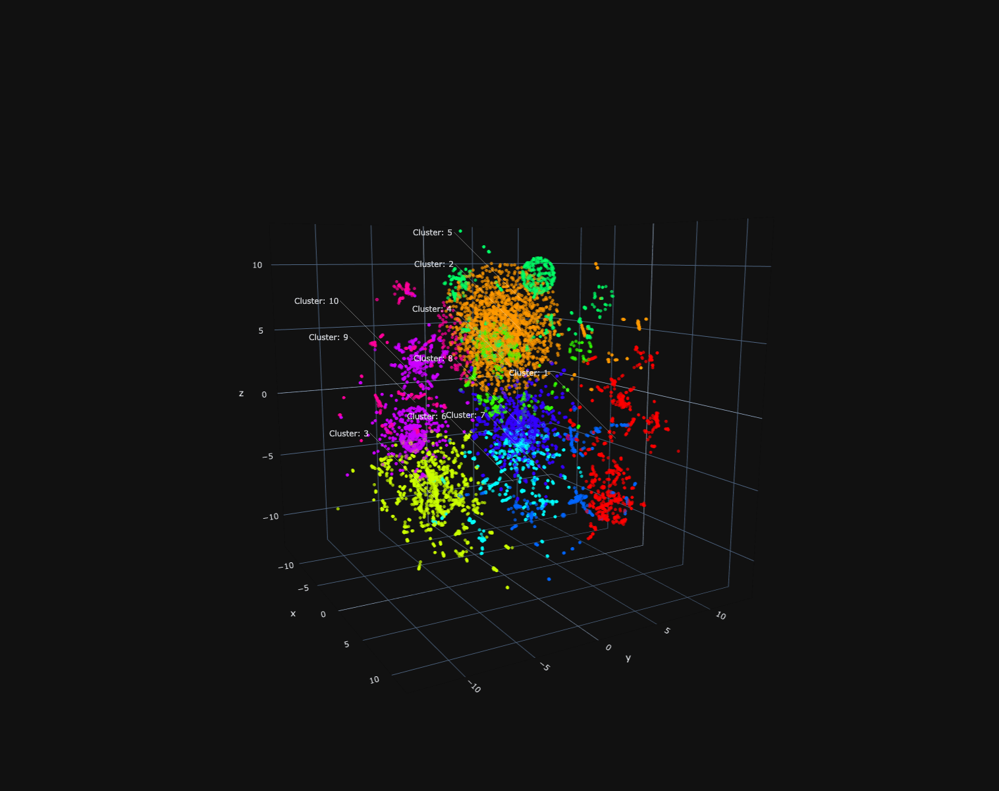

'output_plots/3Dportrait_tsne_MF_correlation_Human.html'

In [30]:
print('Perplexity:', prplxty3d)
print('Early Exaggeration:', density3d)
print('Learning rate:', l_rate3d)
print('Iterations:', steps3d)

fig = pgo.Figure()
for i in tsne_data:
    fig.add_trace(i)
fig.update_layout(template='plotly_dark', showlegend=False, width=1200, height=1200,
                  scene=dict(
                    aspectratio=dict(
                        x=1,
                        y=1,
                        z=1
                    ),
                    camera=dict(
                        center=dict(
                            x=0,
                            y=0,
                            z=0
                        ),
                        eye=dict(
                            x=1.96903462608,
                            y=-1.09022831971,
                            z=0.405345349304
                        ),
                        up=dict(
                            x=0,
                            y=0,
                            z=1
                        )
                    ),
                    dragmode="turntable",
                    annotations=annotations,
                ))
py.iplot(fig)

plotly.offline.plot(fig, filename = 'output_plots/3Dportrait_tsne_'+feature+'_'+metric+'_Human.html', auto_open=False)

In [35]:
df_posG = pd.DataFrame(posG).T

n_clus = 15
n_iterations = 50

d_node_clusterid = get_node_clusterid(df_posG, n_clus, n_iterations)
cluster_center_x, cluster_center_y, cluster_center_z = get_clustercenter_xyz(df_posG, n_clus, n_iterations)

colours = color_nodes_from_dict(G, d_node_clusterid)

trace_centers = pgo.Scatter3d(x = cluster_center_x,
                             y = cluster_center_y,
                             z = cluster_center_z,
                                 mode = 'markers',
                                 marker=dict(
                                    size=3,
                                    color='lightgrey',
                                    opacity=1)
                                 )

annotations = [dict(
                x=xi,
                y=yi,
                z=zi,
                showarrow=True,
                text="Cluster: "+str(i),
                xanchor="right",
                ay=-100,
                ax=-100,
                opacity=0.8,
                arrowhead=0,
                arrowwidth=0.5,
                arrowcolor="white"
                ) for i, xi, yi, zi in zip(range(1,n_clus+1), cluster_center_x,cluster_center_y,cluster_center_z)]

In [36]:
tsne_nodes = get_trace_nodes_(posG, l_features, colours, size3d)

# tsne_data = [tsne_edges, tsne_nodes]
# tsne_data = [tsne_nodes, trace_centers]

tsne_data = [tsne_nodes]

Perplexity: 50
Early Exaggeration: 1.2
Learning rate: 200
Iterations: 250


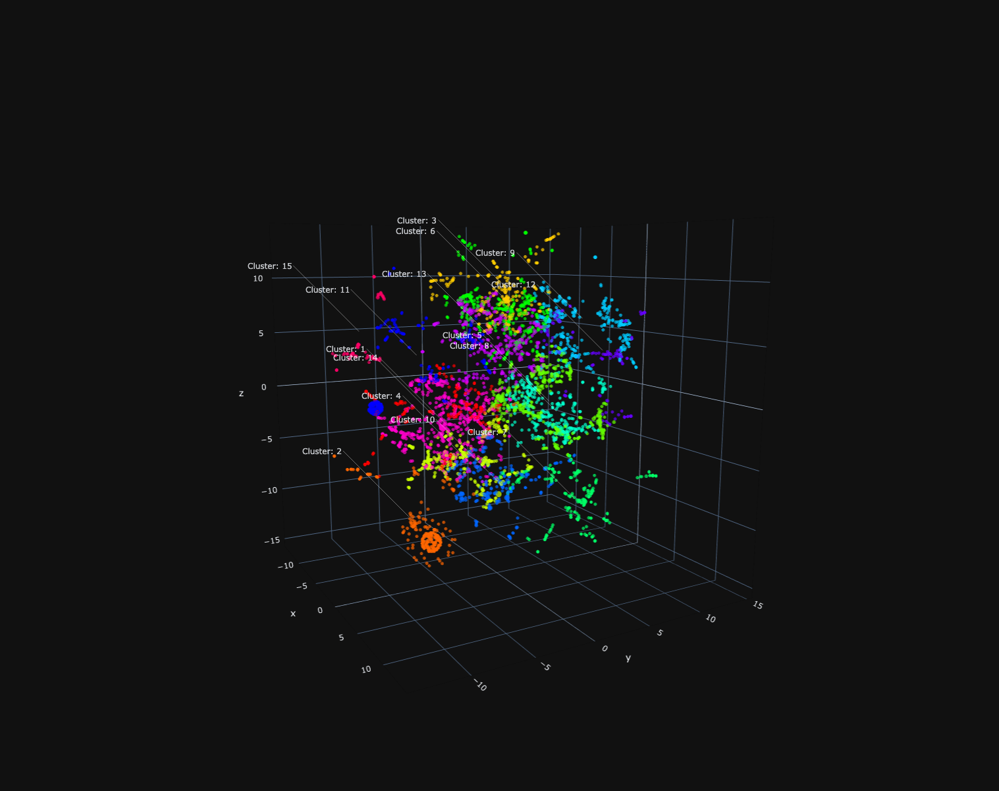

'output_plots/3Dportrait_tsne_disease_correlation_Human.html'

In [37]:
print('Perplexity:', prplxty3d)
print('Early Exaggeration:', density3d)
print('Learning rate:', l_rate3d)
print('Iterations:', steps3d)

fig = pgo.Figure()
for i in tsne_data:
    fig.add_trace(i)
fig.update_layout(template='plotly_dark', showlegend=False, width=1200, height=1200,
                  scene=dict(
                    aspectratio=dict(
                        x=1,
                        y=1,
                        z=1
                    ),
                    camera=dict(
                        center=dict(
                            x=0,
                            y=0,
                            z=0
                        ),
                        eye=dict(
                            x=1.96903462608,
                            y=-1.09022831971,
                            z=0.405345349304
                        ),
                        up=dict(
                            x=0,
                            y=0,
                            z=1
                        )
                    ),
                    dragmode="turntable",
                    annotations=annotations,
                ))
py.iplot(fig)

plotly.offline.plot(fig, filename = 'output_plots/3Dportrait_tsne_'+feature+'_'+metric+'_Human.html', auto_open=False)

In [92]:
def get_trace_edges(G, posG, color_list):
    edge_x = []
    edge_y = []
    edge_z = []
    for edge in G.edges():
        for node in posG.keys():
            if node == edge[1] or node == edge[0]:
                x0, y0, z0 = posG[edge[0]]
                x1, y1, z1 = posG[edge[1]]
                edge_x.append(x0)
                edge_x.append(x1)
                edge_x.append(None)
                edge_y.append(y0)
                edge_y.append(y1)
                edge_y.append(None)
                edge_z.append(z0)
                edge_z.append(z1)
                edge_z.append(None)

    trace_edges = pgo.Scatter3d(
                        x = edge_x, 
                        y = edge_y, 
                        z = edge_z,
                        mode = 'lines', hoverinfo='none',
                        line = dict(width = 0.5, color = color_list),
                        opacity = 0.3
                )
    
    return trace_edges

In [115]:
# fix edges

#%%time
#tsne_edges = get_trace_edges(G, posG, edge_color)